# Start to end test

In [1]:
#Specify device
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0" 
# os.environ["CUDA_VISIBLE_DEVICES"] = ""  # For CPU inference

In [2]:
 # dynamically grow the memory used on the GPU
from tensorflow.compat.v1.keras.backend import set_session
import tensorflow as tf
config = tf.compat.v1.ConfigProto()
config.gpu_options.allow_growth = True 
sess = tf.compat.v1.Session(config=config)
set_session(sess)

Before runing this test, please download models from [https://nomeroff.net.ua/models/](https://nomeroff.net.ua/models/) to **./models/** directory. 

In [3]:
# Import all necessary libraries.
import numpy as np
import sys
import glob
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
import cv2
from termcolor import colored

plt.rcParams["figure.figsize"] = (20,10)

In [4]:
# NomeroffNet path
NOMEROFF_NET_DIR = os.path.abspath('../')

# specify the path to Mask_RCNN if you placed it outside Nomeroff-net project
CRAFT_DIR = os.path.join(NOMEROFF_NET_DIR, 'CRAFT-pytorch')

sys.path.append(NOMEROFF_NET_DIR)
sys.path.append(CRAFT_DIR)

In [5]:
from NomeroffNet.MmdetectionDetector import Detector

detector = Detector()
detector.loadModel(cfg_path = '../models/faster_rcnn_r50_caffe_fpn_mstrain_1x_numberpale.py',
                 checkpoint_file = '../models//epoch_12.pth',
                 devie='cuda:0')

Use load_from_local loader


In [6]:
from NomeroffNet.BBoxNpPoints import NpPointsCraft

npPointsCraft = NpPointsCraft()
npPointsCraft.load()

Loading weights from checkpoint (/var/www/nomeroff-netv2/nomeroff-net/weights/craft_mlt_25k.pth)
Loading weights of refiner from checkpoint (/var/www/nomeroff-netv2/nomeroff-net/weights/craft_refiner_CTW1500.pth)


In [7]:
from NomeroffNet.OptionsDetector import OptionsDetector
from NomeroffNet.TextDetector import TextDetector

# Import license plate recognition tools.
from NomeroffNet.RectDetector import  RectDetector

rectDetector = RectDetector()

optionsDetector = OptionsDetector()
optionsDetector.load("latest")

# Initialize text detector.
textDetector = TextDetector({
    "eu_ua_2004_2015": {
        "for_regions": ["eu_ua_2015", "eu_ua_2004"],
        "model_path": "latest"
    },
    "eu_ua_1995": {
        "for_regions": ["eu_ua_1995"],
        "model_path": "latest"
    },
    "eu": {
        "for_regions": ["eu"],
        "model_path": "latest"
    },
    "ru": {
        "for_regions": ["ru", "eu-ua-fake-lnr", "eu-ua-fake-dnr"],
        "model_path": "latest" 
    },
    "kz": {
        "for_regions": ["kz"],
        "model_path": "latest"
    },
    "ge": {
        "for_regions": ["ge"],
        "model_path": "latest"
    },
    "su": {
        "for_regions": ["su"],
        "model_path": "latest"
    }
})

In [8]:
import cv2
import numpy as np

async def test(dirName, fname, y, min_bbox_acc = 0.5, verbose=0):
    nGood = 0
    nBad  = 0
    img_path = os.path.join(dirName, fname)
    if verbose==1:
        print(colored(f"__________ \t\t {img_path} \t\t __________", "blue"))
    img = cv2.imread(img_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    image_bboxs = detector.detect_bbox([img], min_bbox_acc=min_bbox_acc)
    targetBoxes = image_bboxs[0]
    
    all_points = npPointsCraft.detect(img, targetBoxes)
    # for  images/14.jpeg bug
    all_points = [ps for ps in all_points if len(ps)]
    
    # cut zones
    zones = rectDetector.get_cv_zonesBGR(img, all_points)
    toShowZones = rectDetector.get_cv_zonesRGB(img, all_points)
    for zone, points in zip(toShowZones, all_points):
        plt.axis("off")
        plt.imshow(zone)
        plt.show()

    # find standart
    regionIds, stateIds, countLines = optionsDetector.predict(zones)
    regionNames = optionsDetector.getRegionLabels(regionIds)
    print(regionNames)
    print(countLines)

    # find text with postprocessing by standart  
    textArr = textDetector.predict(zones, regionNames, countLines)
    print(textArr)
    
     # draw rect and 4 points
    for targetBox, points in zip(targetBoxes, all_points):
        # draw 
        cv2.rectangle(img, 
                      (int(targetBox[0]), int(targetBox[1])), 
                      (int(targetBox[2]), int(targetBox[3])), 
                      (0,120,255), 
                      3)
        print(points, points.shape)
        cv2.polylines(img, np.array([points], np.int32), True, (255,120,255),3)
    plt.imshow(img)
    plt.show()

    for yText in y:
        if yText in textArr:
            print(colored(f"OK: TEXT:{yText} \t\t\t RESULTS:{textArr} \n\t\t\t\t\t in PATH:{img_path}", 'green'))
            nGood += 1
        else:
            print(colored(f"NOT OK: TEXT:{yText} \t\t\t RESULTS:{textArr} \n\t\t\t\t\t in PATH:{img_path} ", 'red'))
            nBad += 1
    return nGood, nBad

In [9]:
dirName = "./images"

__________ 		 ./images/0.jpeg 		 __________


/var/www/mmdetection/mmdet/datasets/utils.py:62: UserWarning: "ImageToTensor" pipeline is replaced by "DefaultFormatBundle" for batch inference. It is recommended to manually replace it in the test data pipeline in your config file.
  warnings.warn(


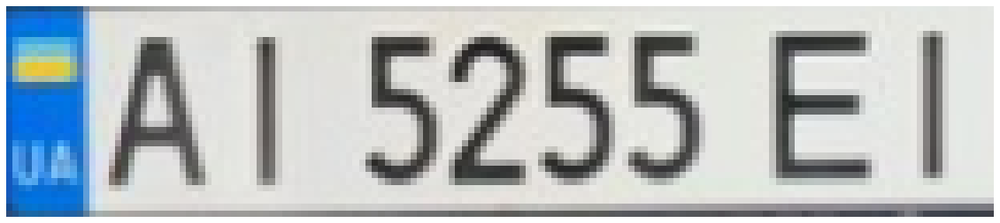

['eu_ua_2015']
[1]
['AI5255EI']
[[368.35998413 278.86666708]
 [368.35998413 312.46665974]
 [202.6800016  312.46665974]
 [202.6800016  278.86666708]] (4, 2)


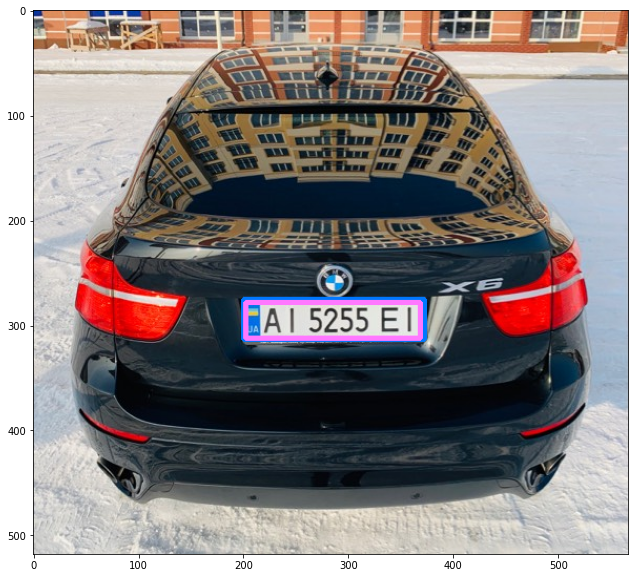

OK: TEXT:AI5255EI 			 RESULTS:['AI5255EI'] 
					 in PATH:./images/0.jpeg
__________ 		 ./images/1.jpeg 		 __________


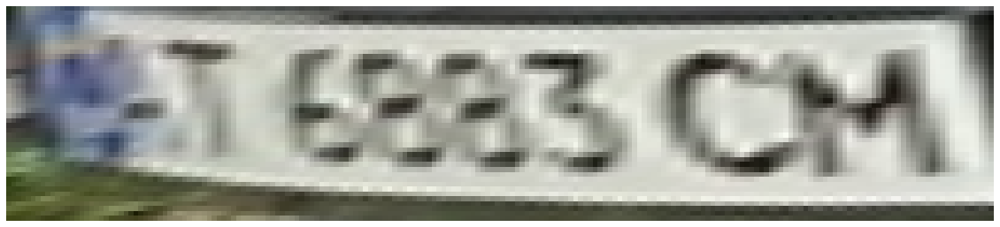

['eu_ua_2015']
[1]
['AT6883CM']
[[ 44.         482.44850397]
 [ 91.         525.17577763]
 [ 91.         569.24849329]
 [ 44.         526.52121937]] (4, 2)


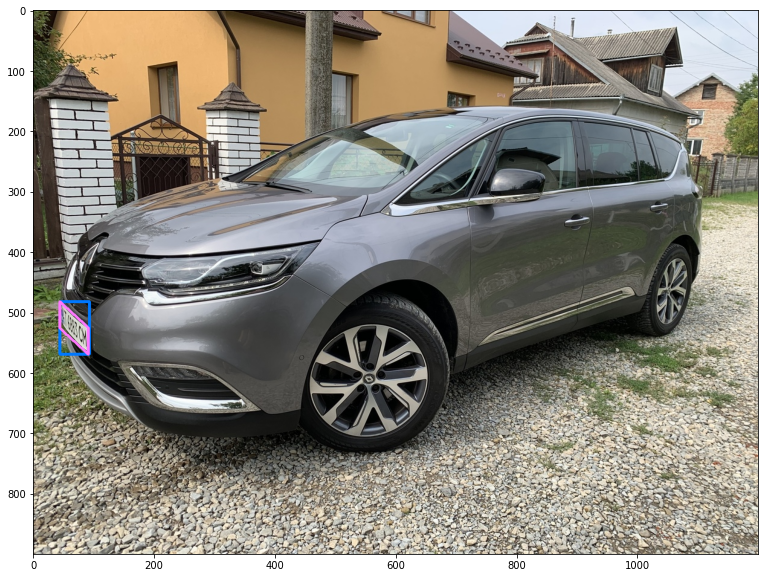

OK: TEXT:AT6883CM 			 RESULTS:['AT6883CM'] 
					 in PATH:./images/1.jpeg
__________ 		 ./images/2.jpeg 		 __________


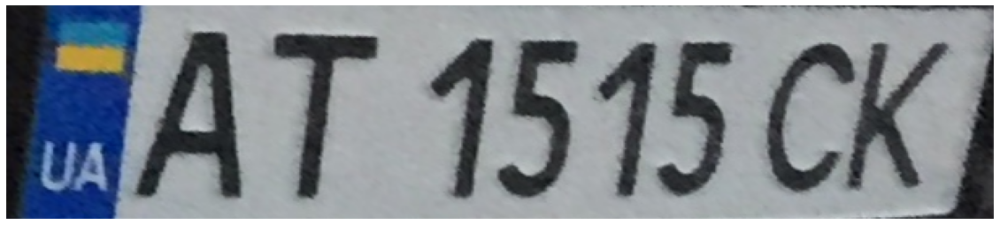

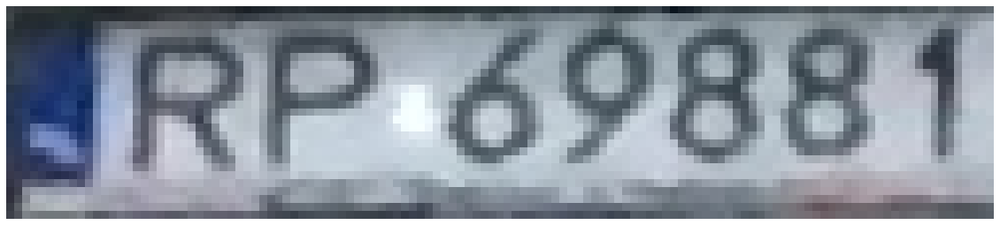

['eu_ua_2015', 'eu']
[1, 1]
['AT1515CK', 'RP69881']
[[3204.06972509 1416.94749227]
 [3204.06972509 1549.63878682]
 [2784.         1733.16441102]
 [2784.         1600.47311002]] (4, 2)
[[2561.          532.7333334 ]
 [2561.          559.93333263]
 [2454.25333309  559.93333263]
 [2454.25333309  532.7333334 ]] (4, 2)


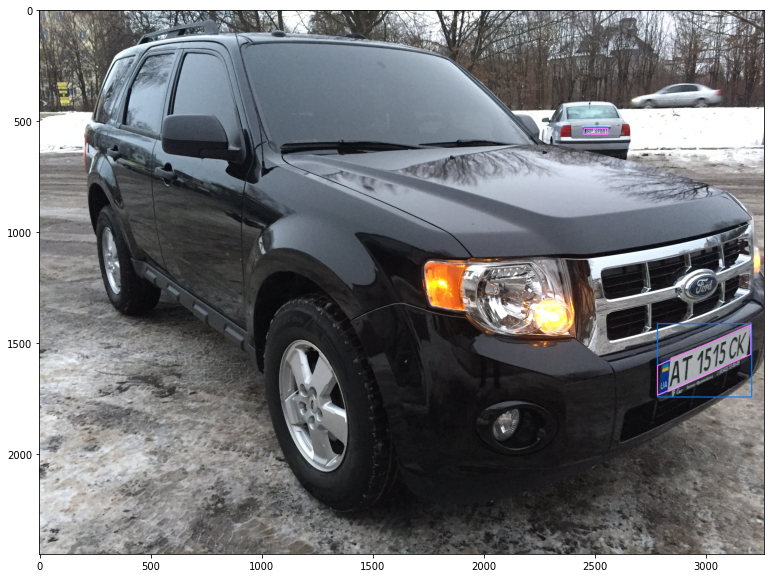

OK: TEXT:AT1515CK 			 RESULTS:['AT1515CK', 'RP69881'] 
					 in PATH:./images/2.jpeg
__________ 		 ./images/3.jpeg 		 __________


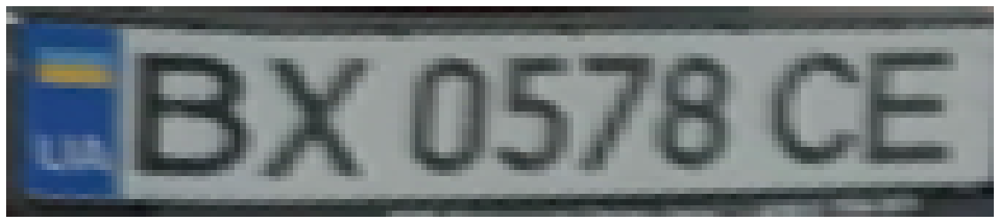

['eu_ua_2015']
[1]
['BX0578CE']
[[994.         590.29230823]
 [994.         627.09231609]
 [912.         664.93846336]
 [912.         628.13845995]] (4, 2)


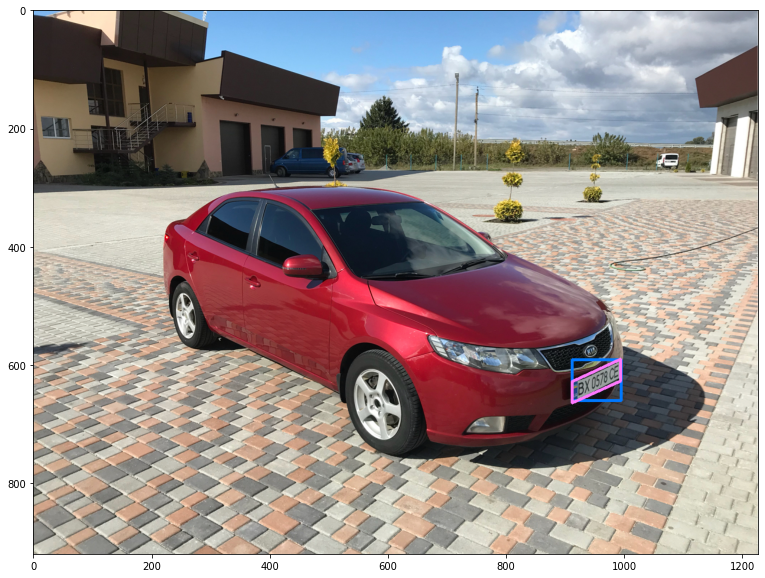

OK: TEXT:BX0578CE 			 RESULTS:['BX0578CE'] 
					 in PATH:./images/3.jpeg
__________ 		 ./images/4.jpeg 		 __________


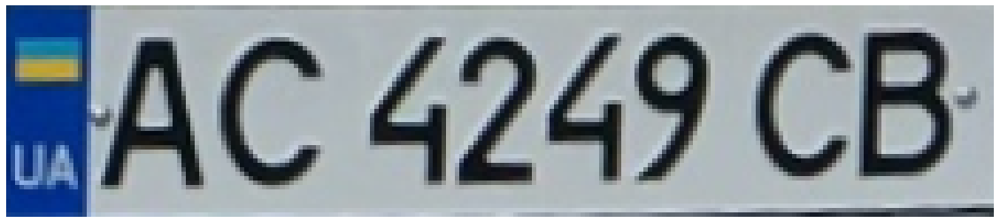

['eu_ua_2015']
[1]
['AC4249CB']
[[1332.91854095  833.84888269]
 [1332.91854095  881.72088635]
 [1124.          894.25600353]
 [1124.          846.38400094]] (4, 2)


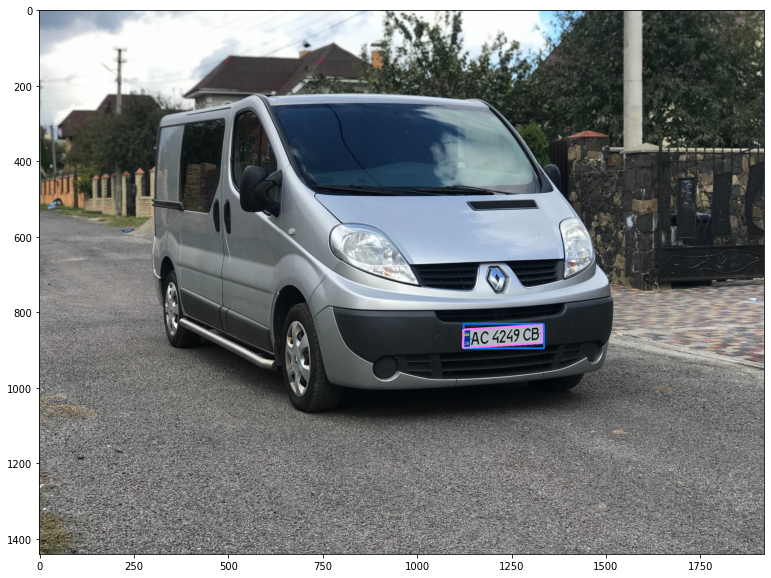

OK: TEXT:AC4249CB 			 RESULTS:['AC4249CB'] 
					 in PATH:./images/4.jpeg
__________ 		 ./images/5.jpeg 		 __________


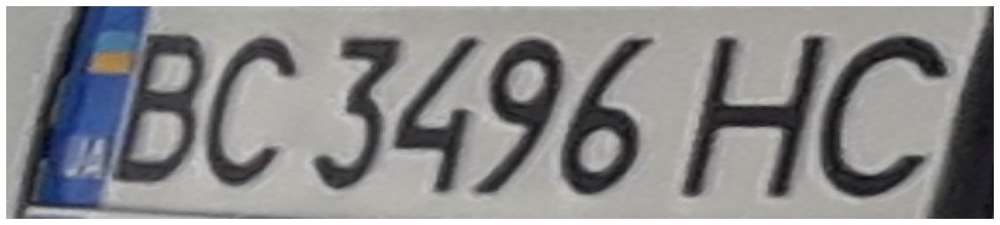

['eu_ua_2015']
[1]
['BC3496HC']
[[ 611.         1547.06111277]
 [ 897.22847231 1627.27802514]
 [ 897.22847231 1741.24491889]
 [ 611.         1661.02801268]] (4, 2)


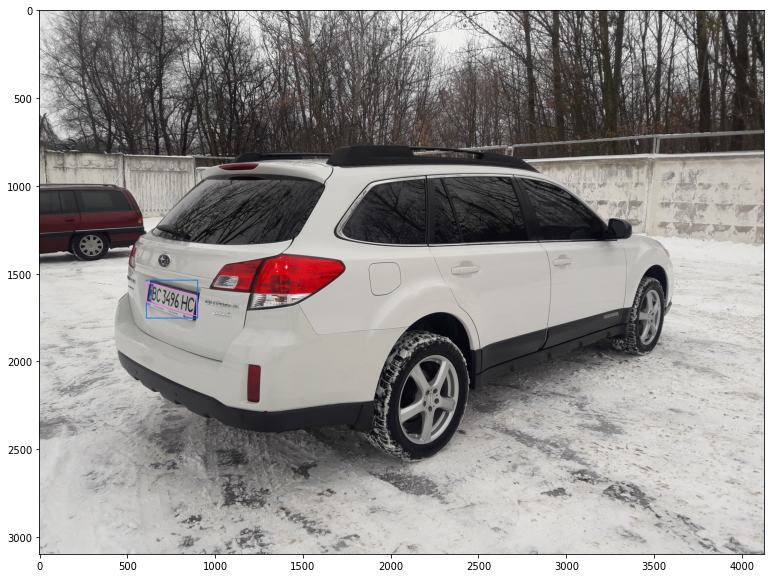

OK: TEXT:BC3496HC 			 RESULTS:['BC3496HC'] 
					 in PATH:./images/5.jpeg
__________ 		 ./images/6.jpeg 		 __________


/var/www/nomeroff-netv2/nomeroff-net/CRAFT-pytorch/craft_utils.py:239: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  polys = np.array(polys)


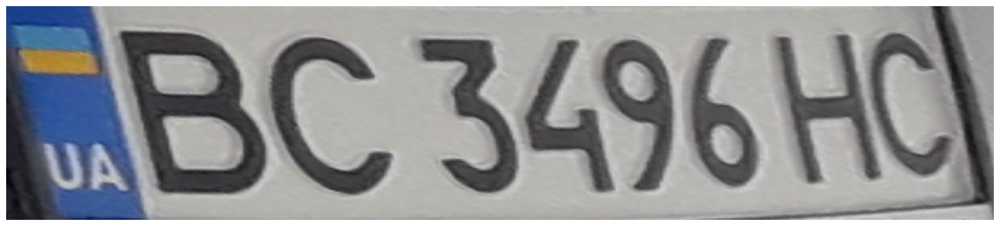

['eu_ua_2015']
[1]
['BC3496HC']
[[3648.         1524.3864545 ]
 [3648.         1668.811451  ]
 [3339.82224342 1818.08505689]
 [3339.82224342 1673.6600466 ]] (4, 2)


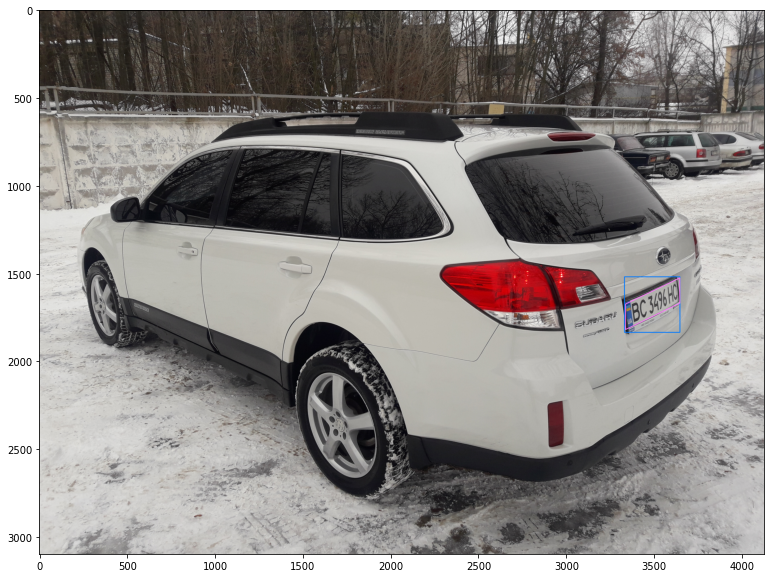

OK: TEXT:BC3496HC 			 RESULTS:['BC3496HC'] 
					 in PATH:./images/6.jpeg
__________ 		 ./images/7.jpeg 		 __________


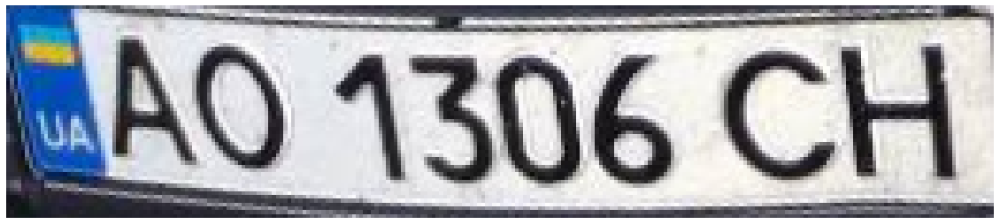

['eu_ua_2015']
[1]
['AO1306CH']
[[109.         675.13017695]
 [365.52879013 736.20844506]
 [365.52879013 792.741775  ]
 [109.         731.6635075 ]] (4, 2)


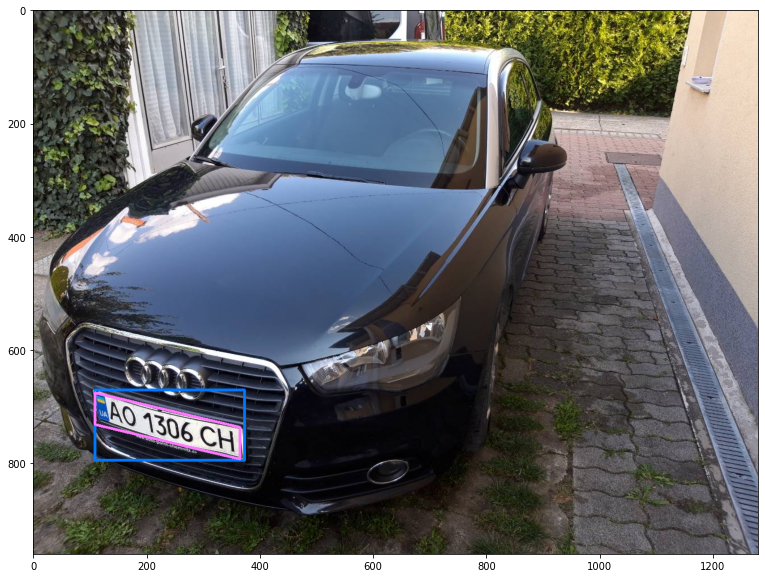

OK: TEXT:AO1306CH 			 RESULTS:['AO1306CH'] 
					 in PATH:./images/7.jpeg
__________ 		 ./images/8.jpeg 		 __________


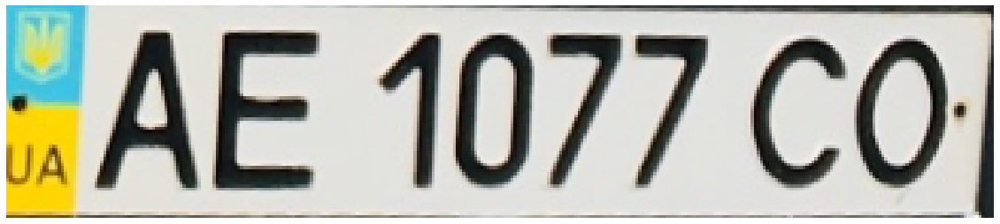

['eu_ua_2004']
[1]
['AE1077CO']
[[1415.          874.72549272]
 [1415.          945.54902555]
 [1073.45975469  975.68493401]
 [1073.45975469  904.86139716]] (4, 2)


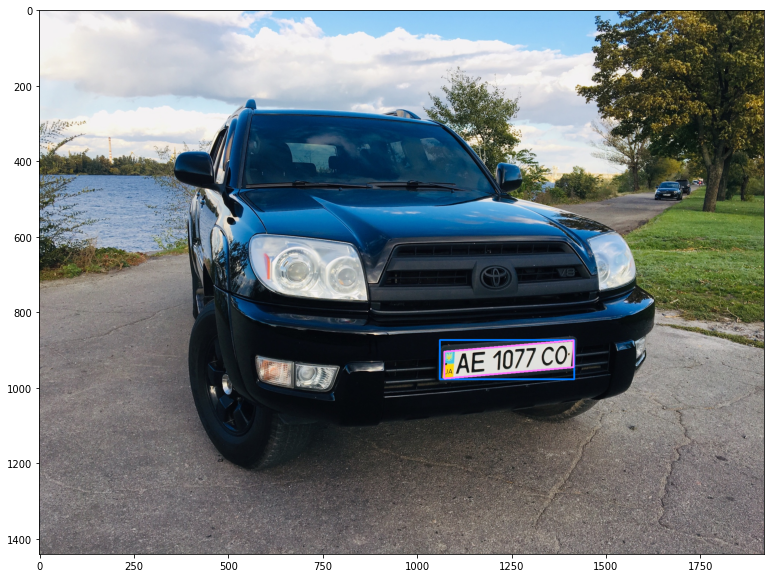

OK: TEXT:AE1077CO 			 RESULTS:['AE1077CO'] 
					 in PATH:./images/8.jpeg
__________ 		 ./images/9.jpeg 		 __________


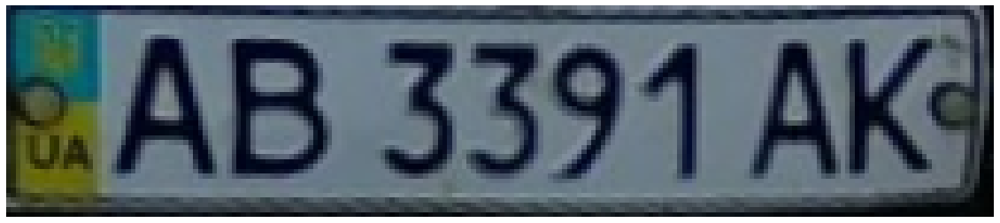

['eu_ua_2004']
[1]
['AB3391AK']
[[1160.          783.14983675]
 [1160.          828.13270269]
 [ 968.65074328  859.11306252]
 [ 968.65074328  814.13020263]] (4, 2)


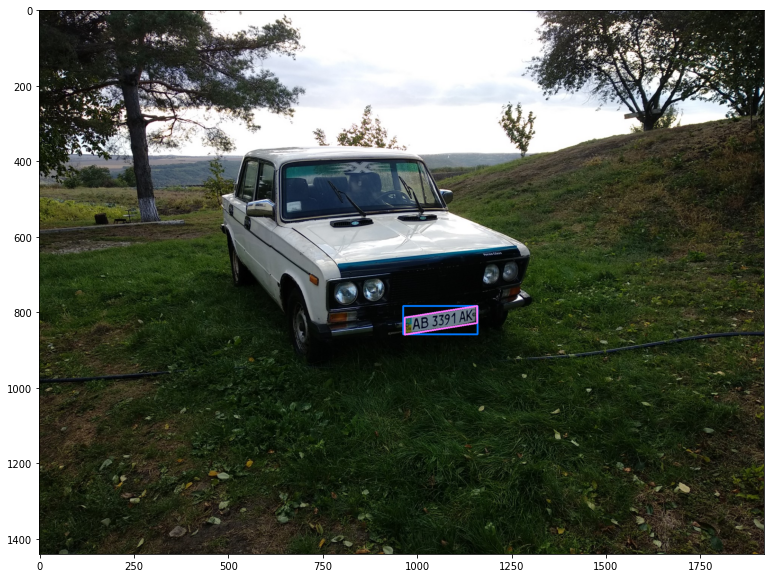

OK: TEXT:AB3391AK 			 RESULTS:['AB3391AK'] 
					 in PATH:./images/9.jpeg
__________ 		 ./images/10.jpeg 		 __________


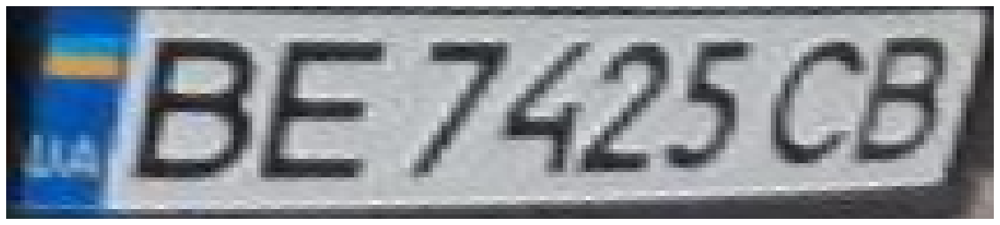

['eu_ua_2015']
[1]
['BE7425CB']
[[1155.          483.46667507]
 [1155.          529.86667546]
 [1051.          571.46666942]
 [1051.          525.06666772]] (4, 2)


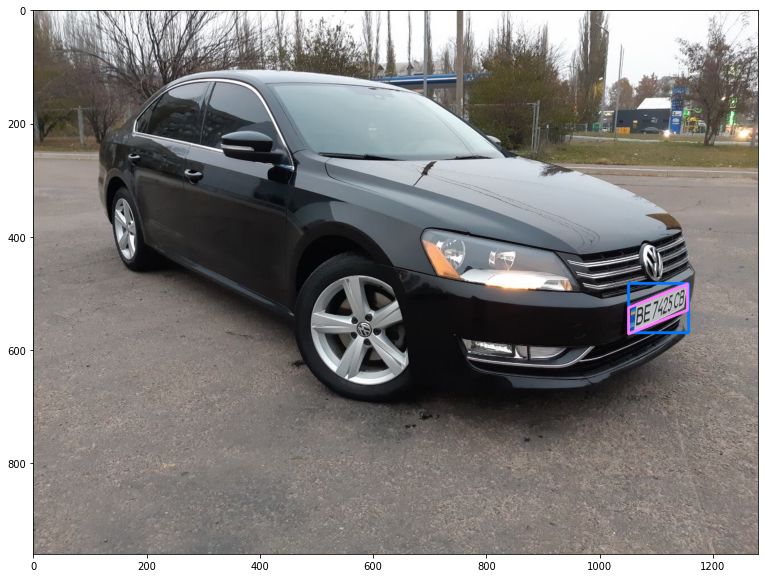

OK: TEXT:BE7425CB 			 RESULTS:['BE7425CB'] 
					 in PATH:./images/10.jpeg
__________ 		 ./images/11.jpeg 		 __________


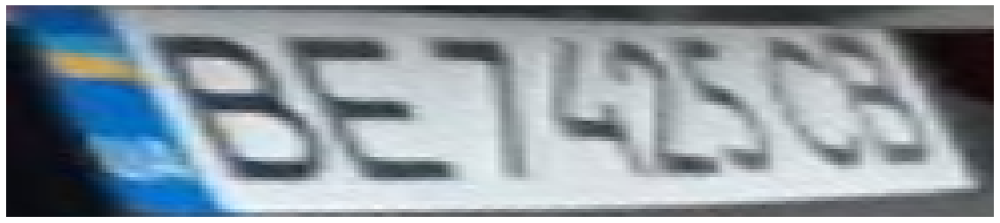

['eu_ua_2015']
[1]
['ABE745CB']
[[1208.          285.69778255]
 [1208.          339.45778968]
 [1131.35340869  380.33596495]
 [1131.35340869  326.5759617 ]] (4, 2)


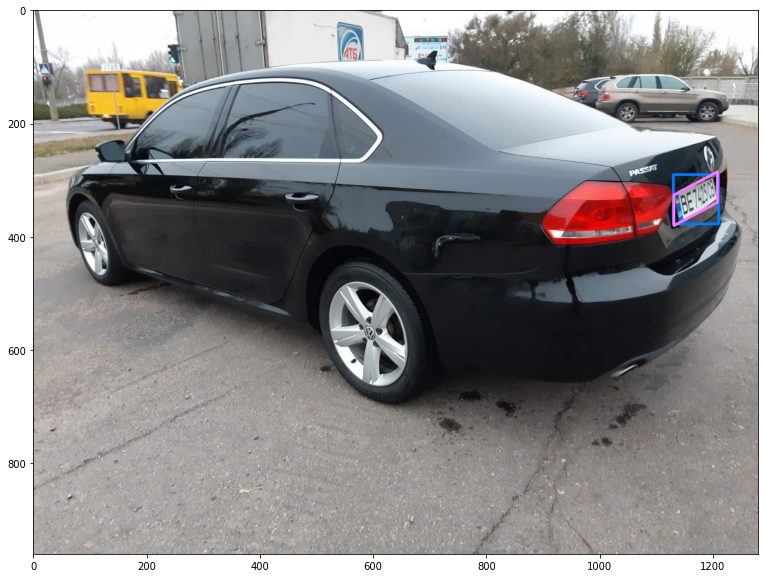

NOT OK: TEXT:BE7425CB 			 RESULTS:['ABE745CB'] 
					 in PATH:./images/11.jpeg 
__________ 		 ./images/12.jpeg 		 __________


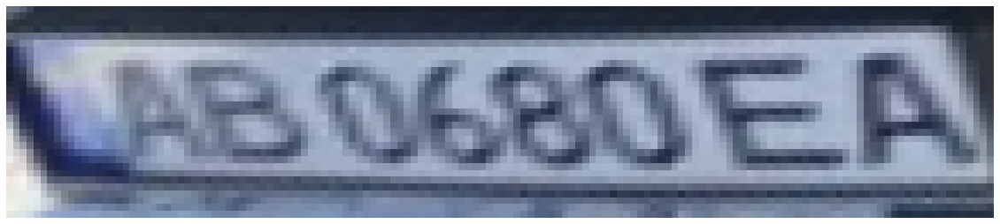

['eu_ua_2015']
[1]
['AB0680EA']
[[ 52.         335.77575107]
 [121.         379.6848372 ]
 [121.         411.10303382]
 [ 52.         367.19394191]] (4, 2)


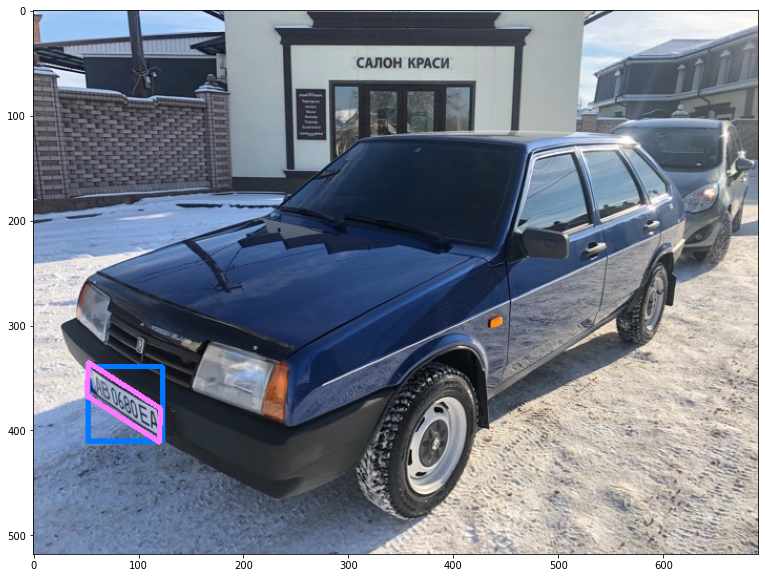

OK: TEXT:AB0680EA 			 RESULTS:['AB0680EA'] 
					 in PATH:./images/12.jpeg
__________ 		 ./images/13.jpeg 		 __________


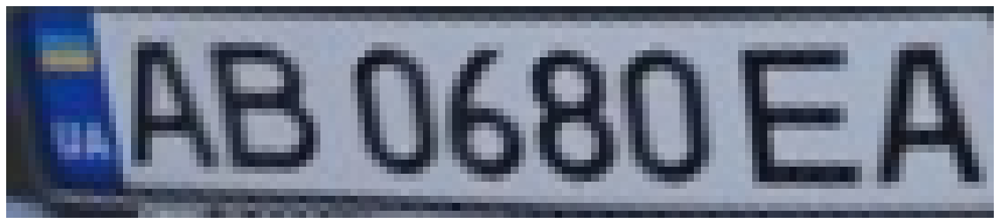

['eu_ua_2015']
[1]
['AB0680EA']
[[131.53815663 392.22064883]
 [271.         430.6231982 ]
 [271.         460.07247442]
 [131.53815663 421.66992475]] (4, 2)


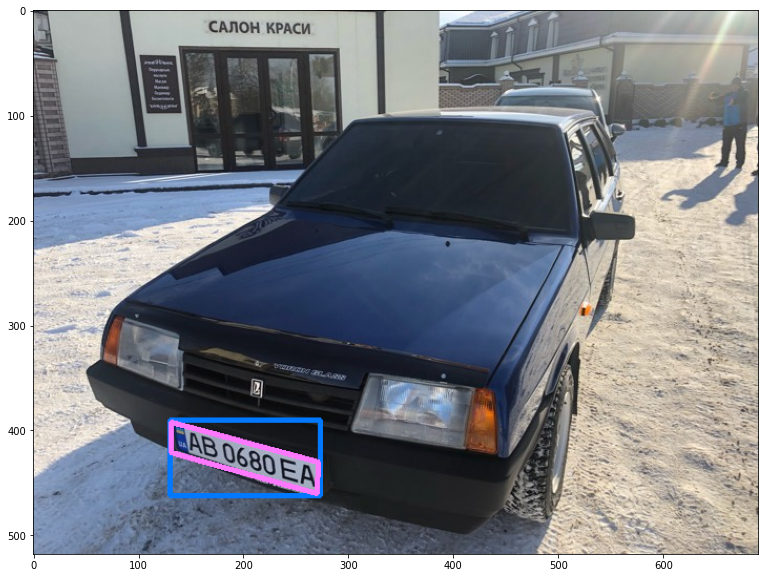

OK: TEXT:AB0680EA 			 RESULTS:['AB0680EA'] 
					 in PATH:./images/13.jpeg
__________ 		 ./images/14.jpeg 		 __________


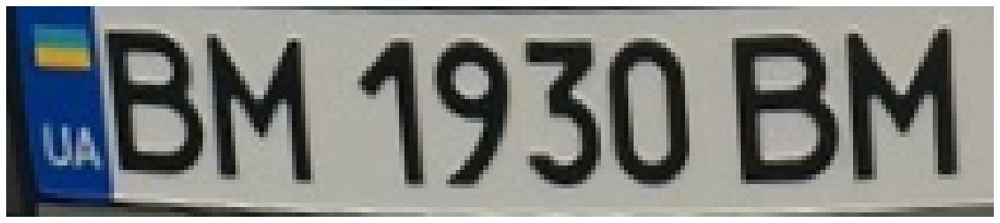

['eu_ua_2015']
[1]
['BM1930BM']
[[167.16105329 777.34785387]
 [412.91721892 793.0344449 ]
 [412.91721892 839.02593541]
 [167.16105329 823.33934657]] (4, 2)


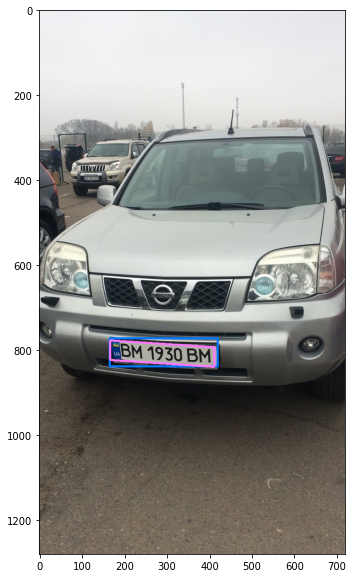

OK: TEXT:BM1930BM 			 RESULTS:['BM1930BM'] 
					 in PATH:./images/14.jpeg
__________ 		 ./images/15.jpeg 		 __________


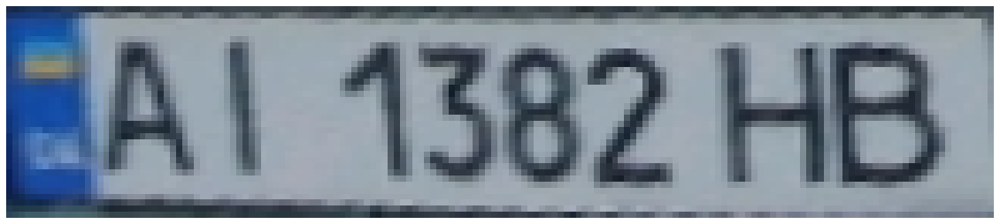

['eu_ua_2015']
[1]
['AI1382HB']
[[ 626.          958.82475511]
 [ 731.          982.82475199]
 [ 731.         1018.29904437]
 [ 626.          994.29904889]] (4, 2)


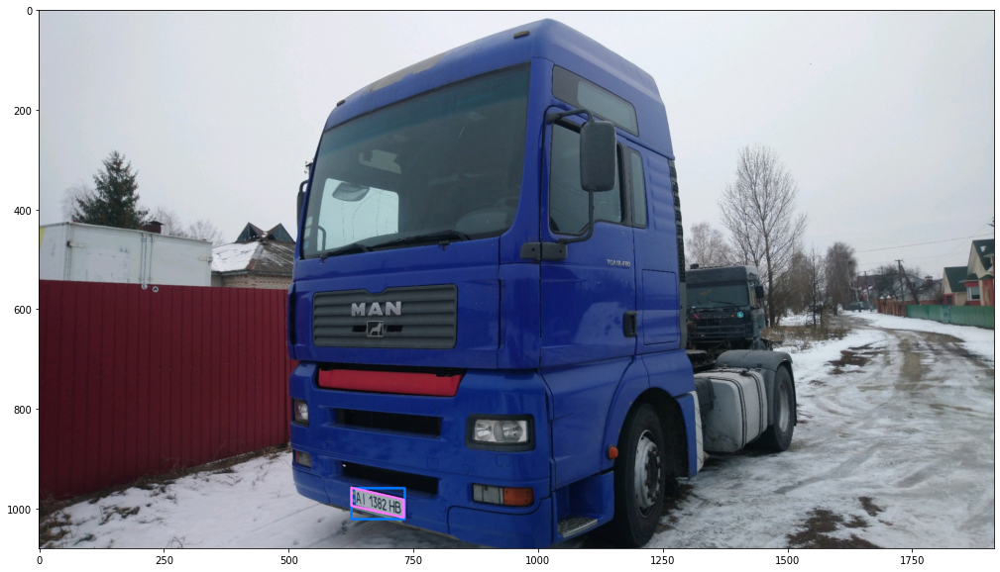

OK: TEXT:AI1382HB 			 RESULTS:['AI1382HB'] 
					 in PATH:./images/15.jpeg
__________ 		 ./images/16.jpeg 		 __________


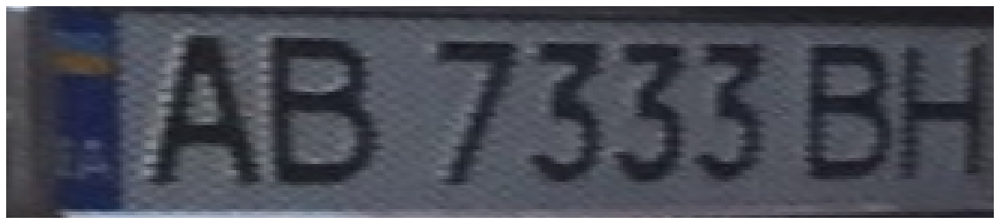

['eu_ua_2015']
[1]
['AB7333BH']
[[1843.67558516  854.19681388]
 [1843.67558516  926.08251739]
 [1709.          974.18094617]
 [1709.          902.2952426 ]] (4, 2)


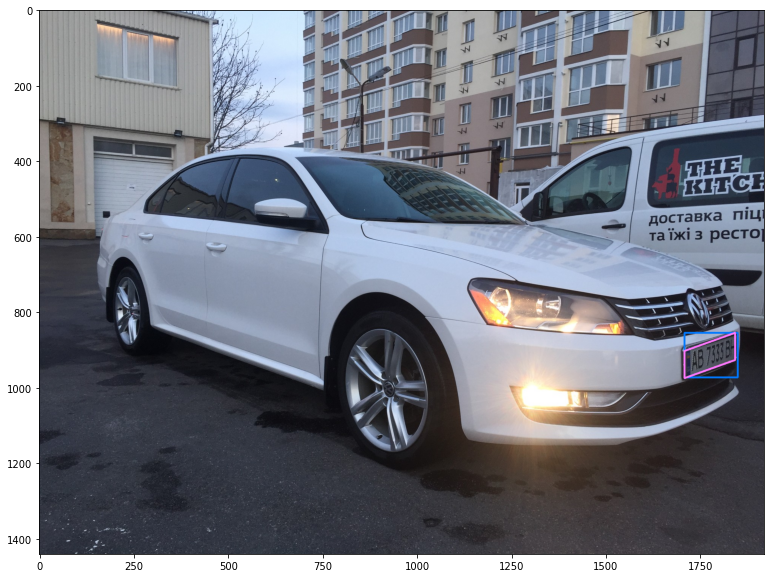

OK: TEXT:AB7333BH 			 RESULTS:['AB7333BH'] 
					 in PATH:./images/16.jpeg
__________ 		 ./images/17.jpeg 		 __________


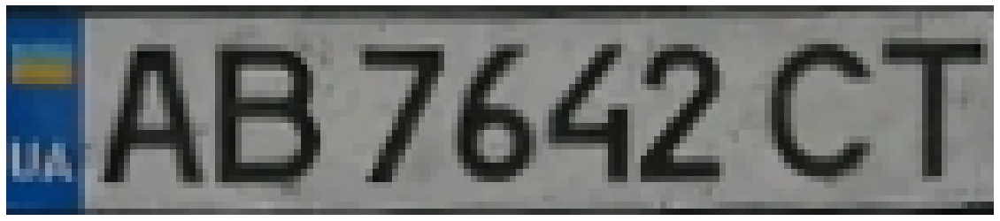

['eu_ua_2015']
[1]
['AB7642CT']
[[796.         910.83670453]
 [796.         943.80748427]
 [642.         950.72883277]
 [642.         917.75805304]] (4, 2)


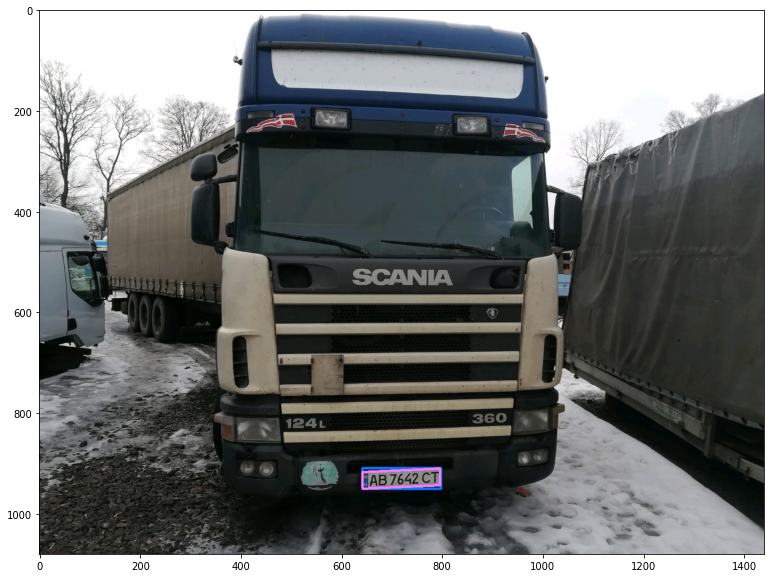

OK: TEXT:AB7642CT 			 RESULTS:['AB7642CT'] 
					 in PATH:./images/17.jpeg
__________ 		 ./images/18.jpeg 		 __________


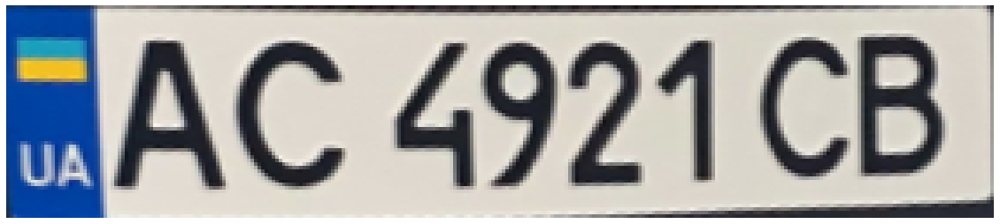

['eu_ua_2015']
[1]
['AC4921CB']
[[1085.18944224  462.38459326]
 [1085.18944224  524.10339336]
 [ 872.53631994  572.52934041]
 [ 872.53631994  510.81054357]] (4, 2)


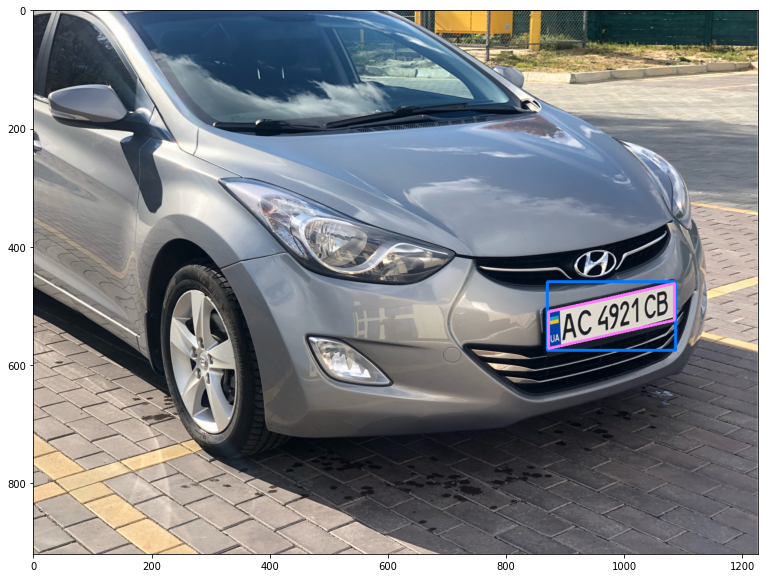

OK: TEXT:AC4921CB 			 RESULTS:['AC4921CB'] 
					 in PATH:./images/18.jpeg
__________ 		 ./images/19.jpeg 		 __________


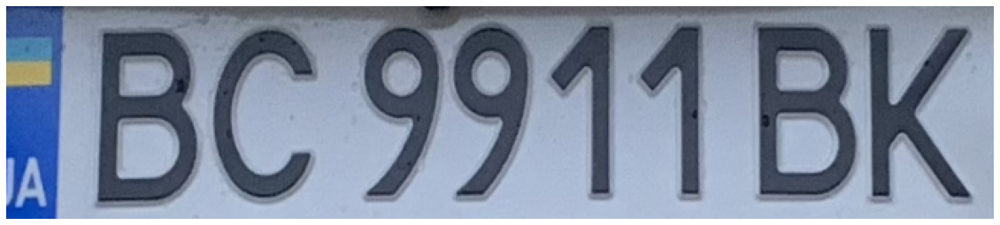

['eu_ua_2015']
[1]
['BC9911BK']
[[1578.0709346  1354.251143  ]
 [2388.78655594 1370.01586837]
 [2388.78655594 1510.96954714]
 [1578.0709346  1495.20482327]] (4, 2)


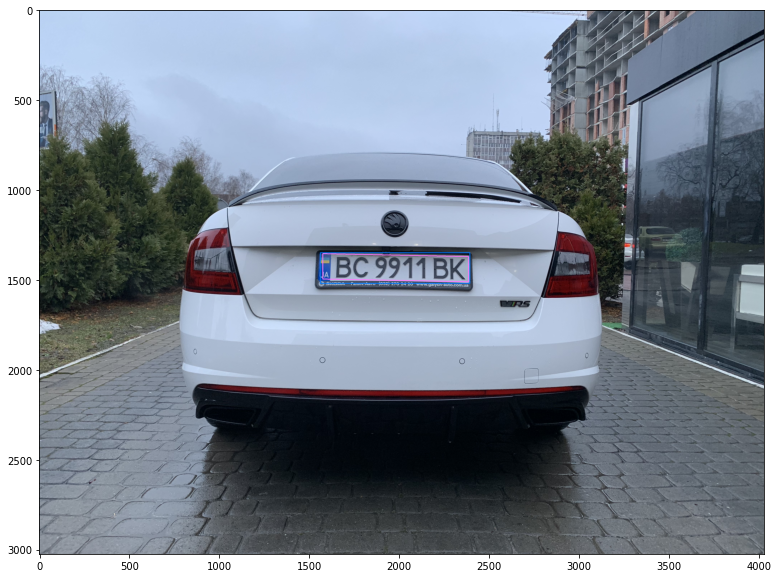

OK: TEXT:BC9911BK 			 RESULTS:['BC9911BK'] 
					 in PATH:./images/19.jpeg
__________ 		 ./images/20.jpeg 		 __________


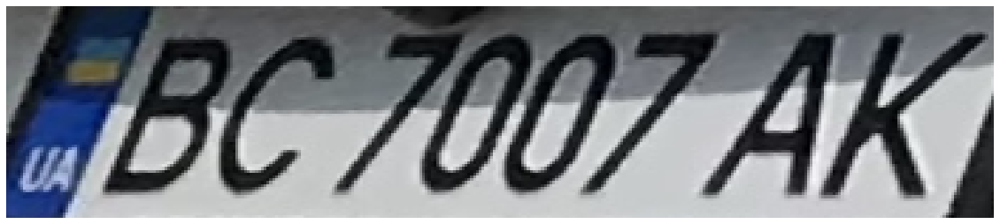

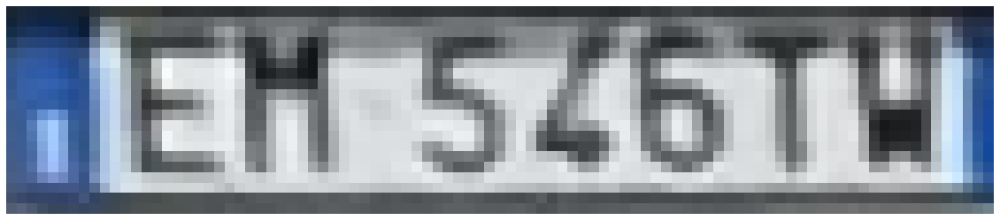

['eu_ua_2015', 'eu']
[1, 1]
['AC007AK', 'EM546TW']
[[ 756.9032847  2156.41539837]
 [ 992.41536052 2205.21520409]
 [ 992.41536052 2281.10710886]
 [ 756.9032847  2232.30729463]] (4, 2)
[[ 484.23999992 1658.2666666 ]
 [ 484.23999992 1679.06666737]
 [ 402.         1679.06666737]
 [ 402.         1658.2666666 ]] (4, 2)


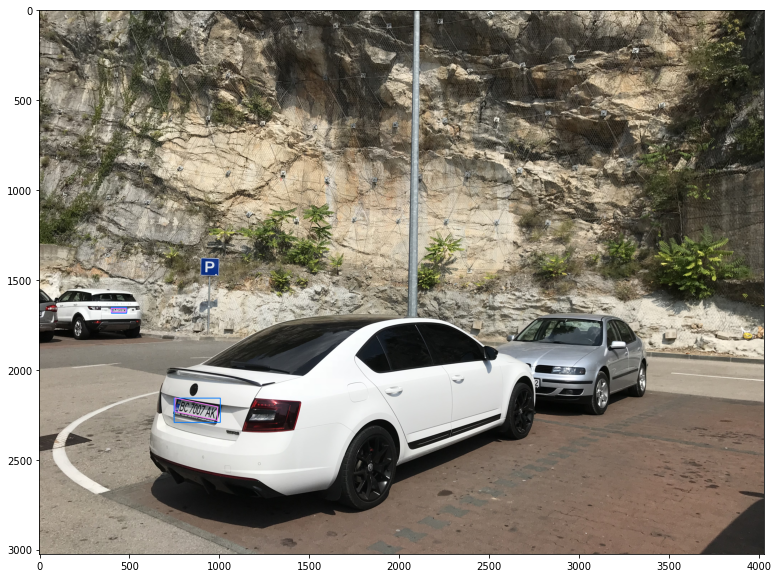

NOT OK: TEXT:BC7007AK 			 RESULTS:['AC007AK', 'EM546TW'] 
					 in PATH:./images/20.jpeg 
__________ 		 ./images/21.jpeg 		 __________


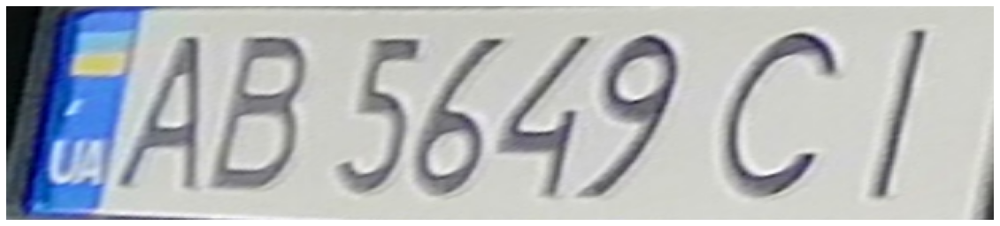

['eu_ua_2015']
[1]
['AB5649CI']
[[ 888.         1940.69697215]
 [1181.7421792  2083.75321165]
 [1181.7421792  2219.18179176]
 [ 888.         2076.12555081]] (4, 2)


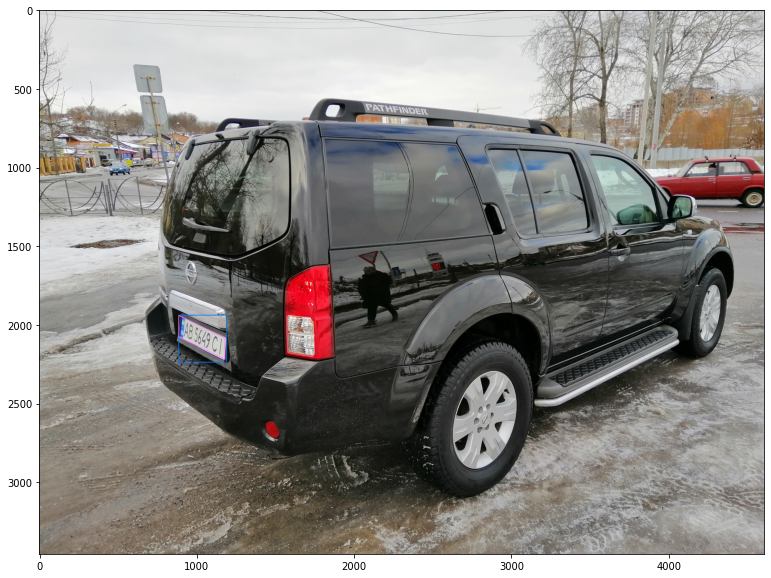

OK: TEXT:AB5649CI 			 RESULTS:['AB5649CI'] 
					 in PATH:./images/21.jpeg
__________ 		 ./images/22.jpeg 		 __________


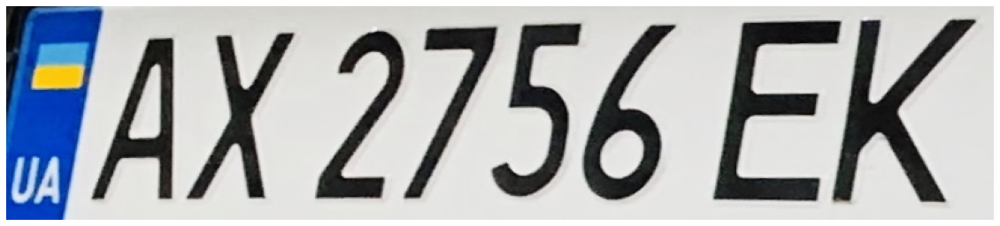

['eu_ua_2015']
[1]
['AX2756EK']
[[1014.90274756 1171.32111916]
 [1014.90274756 1341.61932184]
 [ 369.72817084 1365.08019308]
 [ 369.72817084 1194.78199538]] (4, 2)


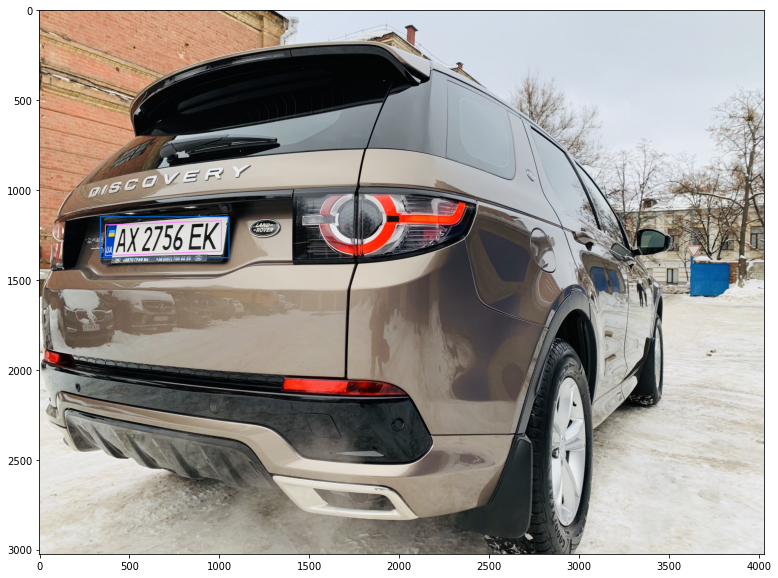

OK: TEXT:AX2756EK 			 RESULTS:['AX2756EK'] 
					 in PATH:./images/22.jpeg
__________ 		 ./images/23.jpeg 		 __________


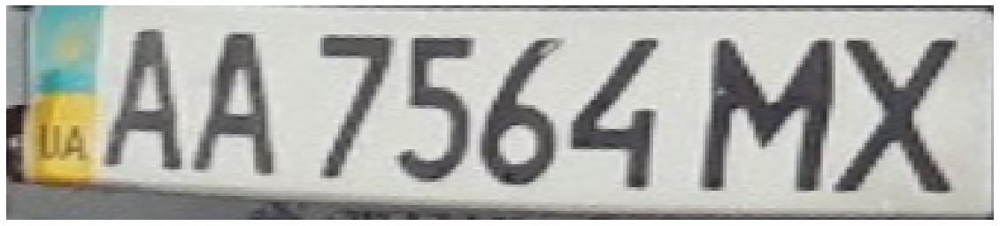

['eu_ua_2004']
[1]
['AA7564MX']
[[ 140.          934.31795141]
 [ 302.          984.16410664]
 [ 302.         1057.27179355]
 [ 140.         1007.42564421]] (4, 2)


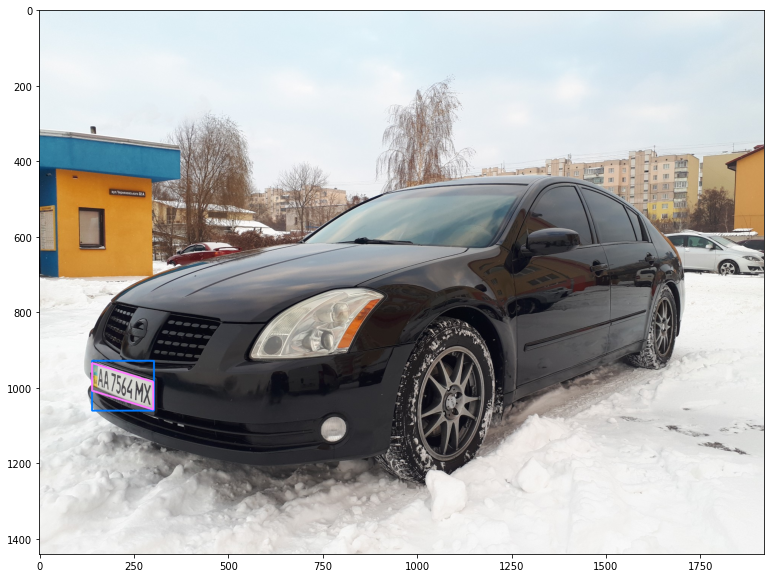

OK: TEXT:AA7564MX 			 RESULTS:['AA7564MX'] 
					 in PATH:./images/23.jpeg
__________ 		 ./images/24.jpeg 		 __________


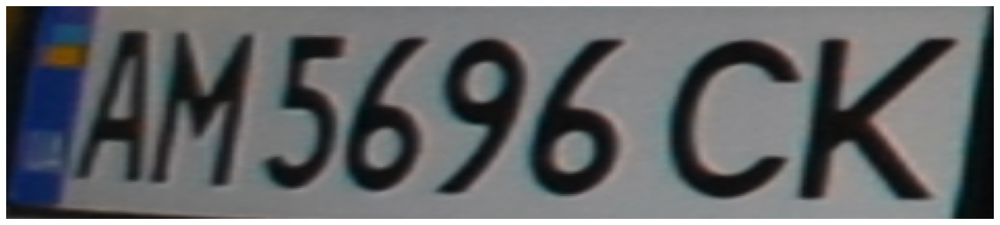

['eu_ua_2015']
[1]
['AM5696CK']
[[ 258.         1486.7887162 ]
 [ 466.21059289 1522.07865206]
 [ 466.21059289 1625.97016153]
 [ 258.         1590.68023103]] (4, 2)


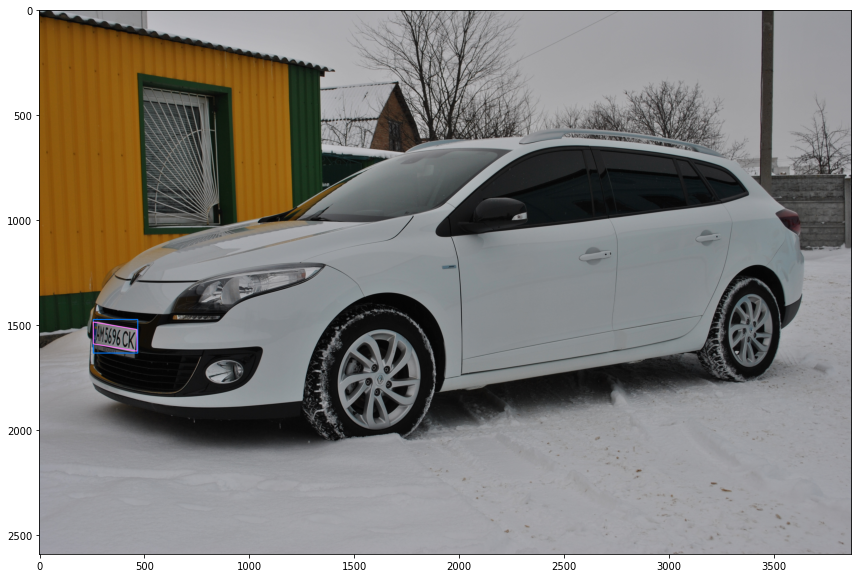

OK: TEXT:AM5696CK 			 RESULTS:['AM5696CK'] 
					 in PATH:./images/24.jpeg
__________ 		 ./images/25.jpeg 		 __________


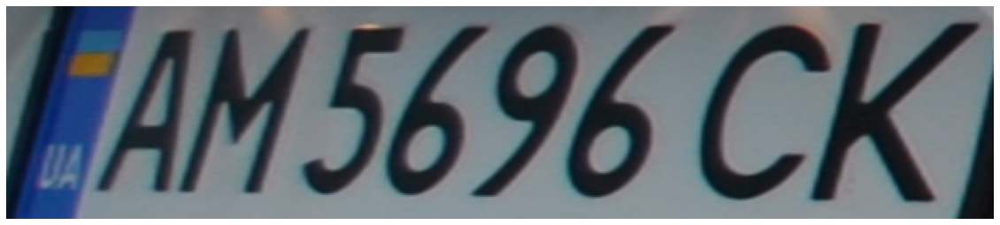

['eu_ua_2015']
[1]
['AM5696CK']
[[ 149.         1545.63407913]
 [ 499.81424315 1591.72646104]
 [ 499.81424315 1717.63594422]
 [ 149.         1671.54356056]] (4, 2)


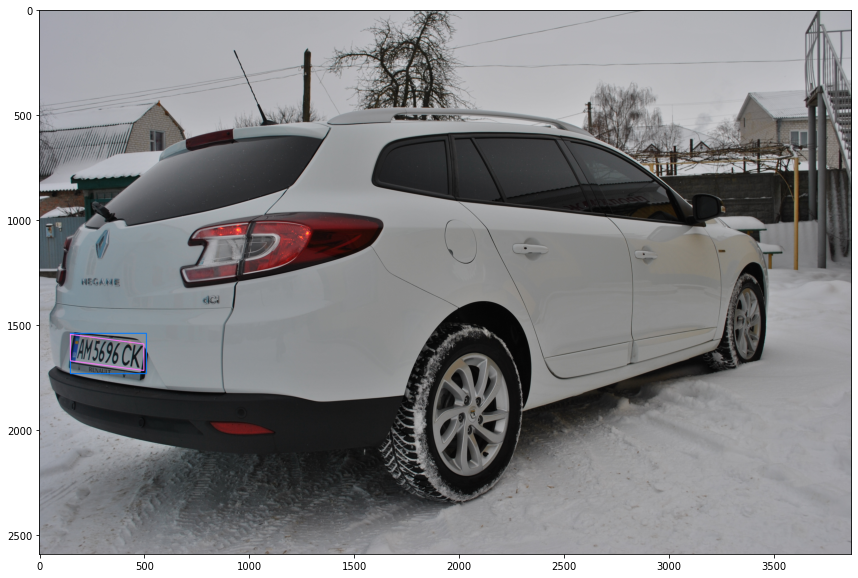

OK: TEXT:AM5696CK 			 RESULTS:['AM5696CK'] 
					 in PATH:./images/25.jpeg
TOTAL GOOD: 0.9230769230769231
TOTAL BED: 0.07692307692307693


In [10]:
testData = {
    "0.jpeg": ["AI5255EI"],
    "1.jpeg": ["AT6883CM"],
    "2.jpeg": ["AT1515CK"],
    "3.jpeg": ["BX0578CE"],
    "4.jpeg": ["AC4249CB"],
    "5.jpeg": ["BC3496HC"],
    "6.jpeg": ["BC3496HC"],
    "7.jpeg": ["AO1306CH"],
    "8.jpeg": ["AE1077CO"],
    "9.jpeg": ["AB3391AK"],
    "10.jpeg": ["BE7425CB"],
    "11.jpeg": ["BE7425CB"],
    "12.jpeg": ["AB0680EA"],
    "13.jpeg": ["AB0680EA"],
    "14.jpeg": ["BM1930BM"],
    "15.jpeg": ["AI1382HB"],
    "16.jpeg": ["AB7333BH"],
    "17.jpeg": ["AB7642CT"],
    "18.jpeg": ["AC4921CB"],
    "19.jpeg": ["BC9911BK"],
    "20.jpeg": ["BC7007AK"],
    "21.jpeg": ["AB5649CI"],
    "22.jpeg": ["AX2756EK"],
    "23.jpeg": ["AA7564MX"],
    "24.jpeg": ["AM5696CK"],
    "25.jpeg": ["AM5696CK"],
}

gGood = 0
gBad = 0
i = 0
for fileName in testData.keys():
    nGood, nBad = await test(dirName, fileName, testData[fileName], verbose=1)
    gGood += nGood
    gBad += nBad
    i += 1
total = gGood + gBad
print(f"TOTAL GOOD: {gGood/total}")
print(f"TOTAL BED: {gBad/total}")